## impoerting relevant libraries

In [2]:
import pandas as pd
import numpy as np
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.neighbors import KNeighborsClassifier
from sklearn.pipeline import Pipeline
import re
import matplotlib.pyplot as plt
import plotly.express as px
import nltk
import re
import string
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
import os

## loading train data and info

In [9]:
data_path = r'train.txt'  
with open(data_path, 'r', encoding='utf-8') as file:
    lines = file.readlines()
data = [line.strip().split(':::') for line in lines]
df_train = pd.DataFrame(data, columns=['id','title','description', 'genre'])
df_train=df_train.drop('id',axis=1)
df_train=df_train.iloc[1:]
df_train.to_csv(r'dataTrain.csv')

In [15]:
print(df_train.head())

                              title  \
1                 Red Alarm (1995)    
2      End of the Innocence (????)    
3   Tales from the Campfire (2017)    
4             "Mr. Dressup" (1967)    
5     Juchitán de las locas (2002)    

                                         description         genre  
1   At the beginning of the 21st Century, a World...        action  
2   Eighteen year-old Alex, 13 year-old Maggie, a...         drama  
3   Four friends plan a camping trip at a small c...        horror  
4   In this series, Ernie Coombes hosts this simp...        family  
5   According to legend, God gave Vincente Ferrer...   documentary  


In [19]:
df_train.describe().T

,count,unique,top,freq
title,45149,45149,Red Alarm (1995),1
description,45149,45047,Grammy - music award of the American academy ...,12
genre,45149,23,drama,11571


In [21]:
print(df_train.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45149 entries, 1 to 45149
Data columns (total 3 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   title        45149 non-null  object
 1   description  45149 non-null  object
 2   genre        45149 non-null  object
dtypes: object(3)
memory usage: 1.0+ MB
None


In [12]:
print(df_train.isnull().sum())

title          0
description    0
genre          0
dtype: int64


In [17]:
print(df_train.nunique())

title          45149
description    45047
genre             23
dtype: int64


## loading test data

In [13]:
data_path = r'C:\Users\parmiss\Desktop\University\AI\Final Project\test.txt'  # Replace with your actual file path
with open(data_path, 'r', encoding='utf-8') as file:
    lines = file.readlines()
data = [line.strip().split(':::') for line in lines]
df_test = pd.DataFrame(data, columns=['id','title','description', 'genre'])
df_test=df_test.drop('id',axis=1)
df_test=df_test.iloc[1:]
df_test.to_csv(r'testTrain.csv')

In [14]:
df_test.head()

,title,description,genre
1,"Io, io, io.... e gli altri (1966)",Sandro is a well-known journalist and he is c...,comedy
2,Ecce Pirate (1997),A young boys life is changed when he's kidnap...,short
3,A zivot jde dál (1935),On the coast of Yugoslavia lives fisherman Iv...,drama
4,"""Policie Modrava"" (2015)",Crime TV show that is a mosaic of individual ...,crime
5,Happiness Under No Guarantee (2009),Adam is a lost soul. He has lost his girlfrie...,short


## EDA training data

### genre distributaion

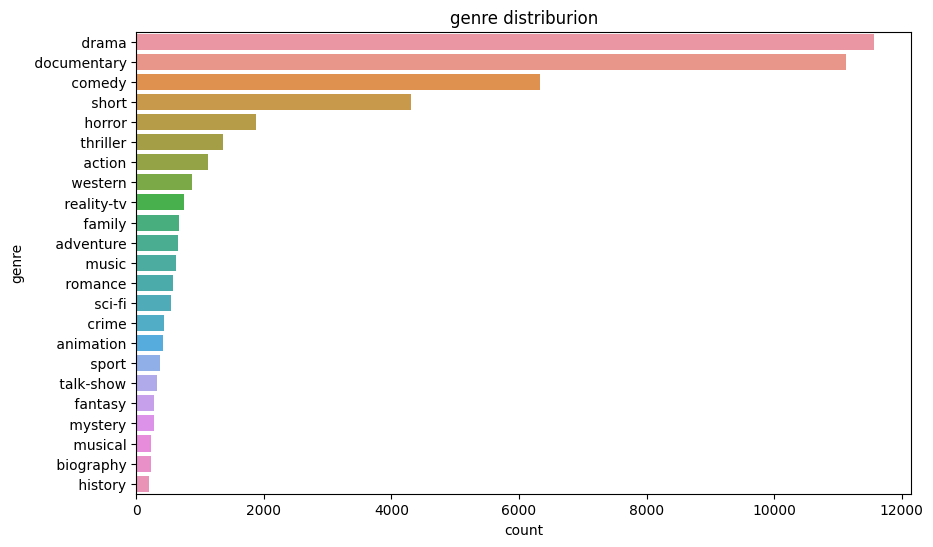

 drama          11571
 documentary    11132
 comedy          6330
 short           4312
 horror          1873
 thriller        1352
 action          1118
 western          877
 reality-tv       751
 family           667
 adventure        659
 music            621
 romance          571
 sci-fi           550
 crime            429
 animation        423
 sport            367
 talk-show        332
 fantasy          275
 mystery          271
 musical          236
 biography        225
 history          207
Name: genre, dtype: int64

In [ ]:
import seaborn as sns
plt.figure(figsize=(10, 6))
sns.countplot(y='genre', data=df_train, order=df_train['genre'].value_counts().index)
plt.title('genre distriburion')
plt.xlabel('count')
plt.ylabel('genre')
plt.show()
df_train['genre'].value_counts().T

### description word count distribution

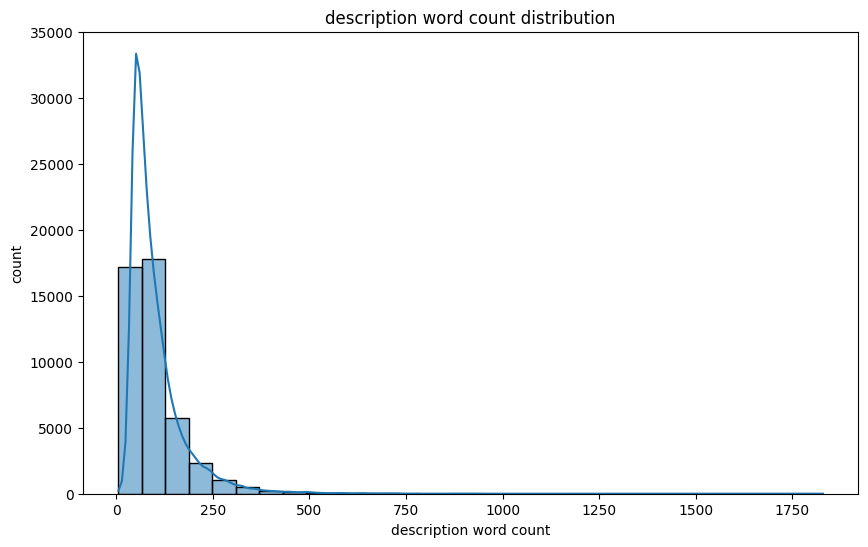

count    45149.000000
mean       102.125806
std         76.702302
min          6.000000
25%         55.000000
50%         79.000000
75%        121.000000
max       1829.000000
Name: description_length, dtype: float64


In [64]:
df_train['description_length'] = df_train['description'].apply(lambda x: len(x.split()))

plt.figure(figsize=(10, 6))
sns.histplot(df_train['description_length'], bins=30, kde=True)
plt.title('description word count distribution')
plt.xlabel('description word count')
plt.ylabel('count')
plt.show()

print(df_train['description_length'].describe())


### genre vs description word count

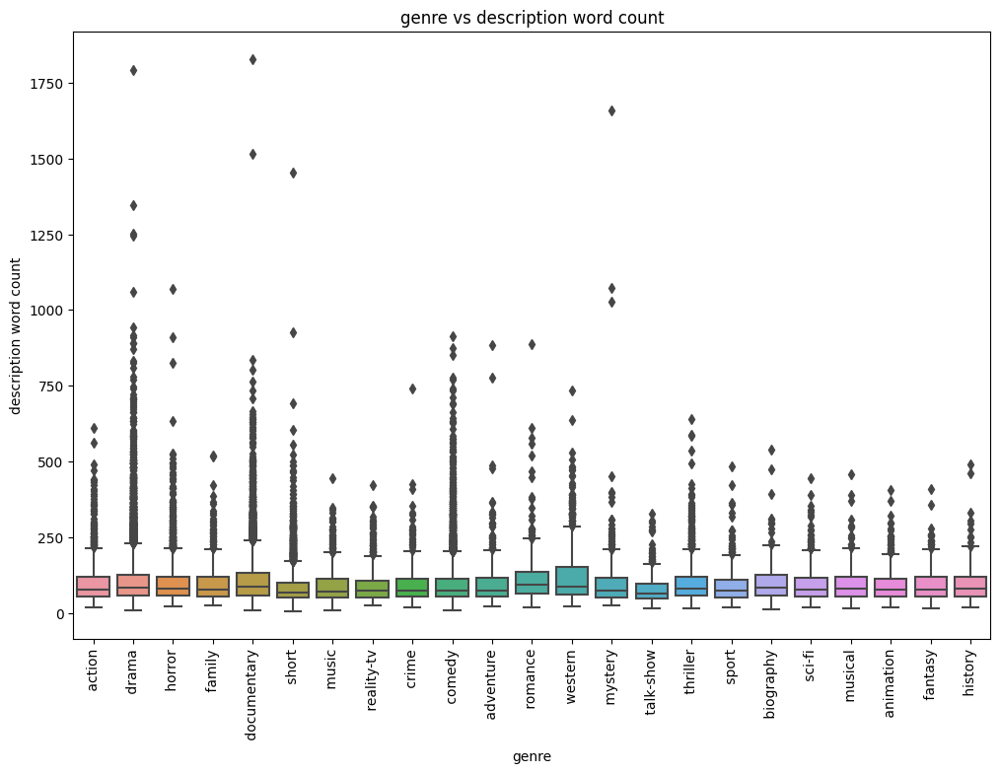

In [65]:
plt.figure(figsize=(12, 8))
sns.boxplot(x='genre', y='description_length', data=df_train)
plt.title('genre vs description word count')
plt.xlabel('genre')
plt.ylabel('description word count')
plt.xticks(rotation=90)
plt.show()

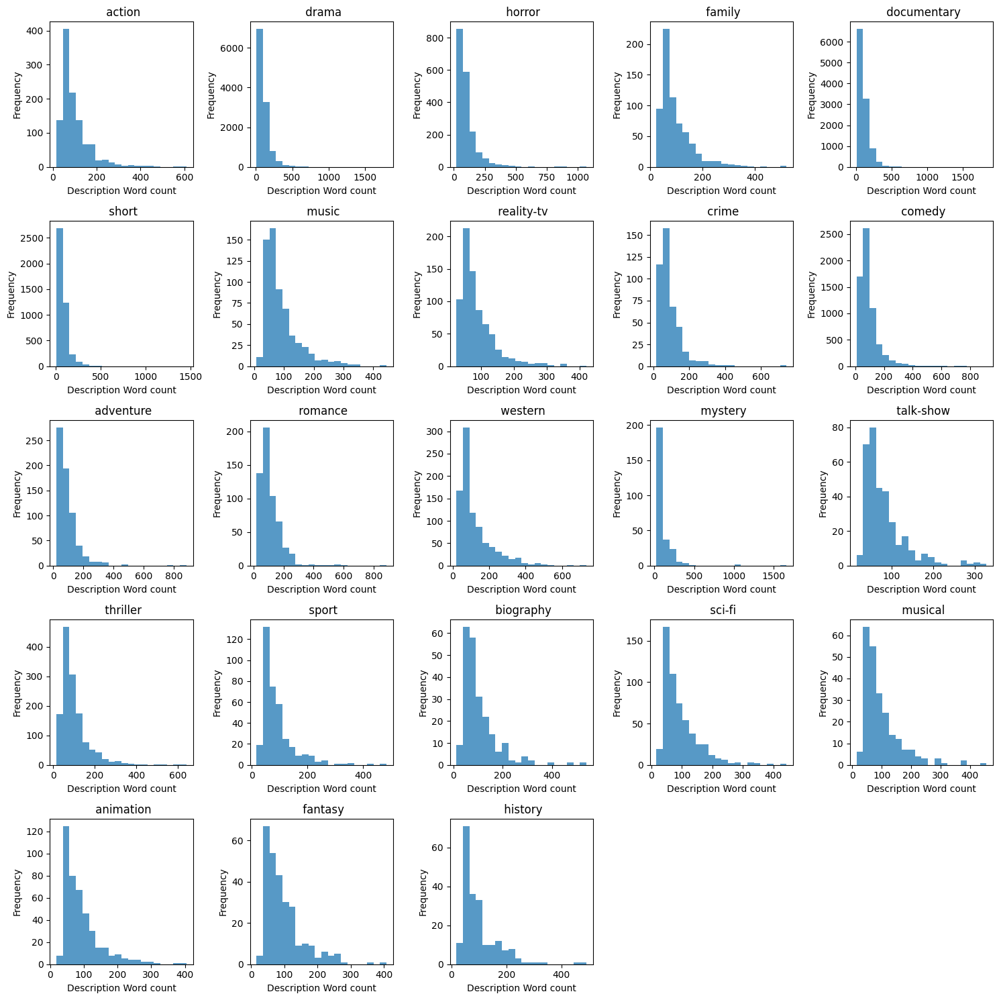

In [69]:
import math
grid_size = math.ceil(math.sqrt(24))
fig, axes = plt.subplots(grid_size, grid_size, figsize=(15, 15))
axes = axes.flatten()  

unique_genres = df_train['genre'].unique()

for i, genre in enumerate(unique_genres):
    axes[i].hist(df_train[df_train['genre'] == genre]['description'].apply(lambda x: len(x.split())), bins=20, alpha=0.75)
    axes[i].set_title(genre)
    axes[i].set_xlabel('Description Word count')
    axes[i].set_ylabel('Frequency')

for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

General Observations:

Most of the histograms are right-skewed, indicating that the majority of descriptions are relatively short.
Some genres have a wider range of description lengths, suggesting more variability in the description content.
Genre-specific Observations:

Action, Adventure, and Thriller: These genres typically have a larger proportion of shorter descriptions, with frequencies decreasing as description length increases. However, there are occasional longer descriptions present.
Drama and Documentary: These genres tend to have the longest descriptions on average. The frequency of descriptions does not drop off as quickly, indicating that longer descriptions are more common.
Comedy and Family: These genres have a moderate range of description lengths but generally lean towards shorter descriptions.
Short Films: As expected, descriptions for short films tend to be shorter, likely reflecting the shorter content.
Music and Reality-TV: These genres also have a broad range of description lengths, but shorter descriptions are more frequent.
Crime and Mystery: These genres show a similar pattern to Action and Thriller, with a steep drop-off in frequency as description length increases.
Romance and Western: These genres show variability but tend to have more shorter descriptions, similar to many other genres.
Talk-show and Sport: These genres have a more limited range of description lengths, generally skewed towards shorter descriptions.
Biography and Sci-fi: These genres show a moderate range of description lengths, with the frequency decreasing for longer descriptions.
Musical, Animation, and Fantasy: These genres have a variety of description lengths but with a higher frequency of shorter ones.
History: This genre tends to have longer descriptions, similar to Documentary and Drama.
Outliers and Anomalies:

The 'genre' subplot might indicate a mislabeling issue in the dataset, where 'genre' itself was treated as a genre label. This needs to be cleaned from the dataset.
Some genres like 'Short' and 'Documentary' might have descriptions significantly longer or shorter than expected, which could indicate inconsistencies or errors in the data entry.
Histogram Peaks:

Peaks at shorter description lengths (e.g., around 100-500 characters) are common across most genres. This suggests a standard format or limitation in description length used frequently across the dataset.

### word frequency in descriptions

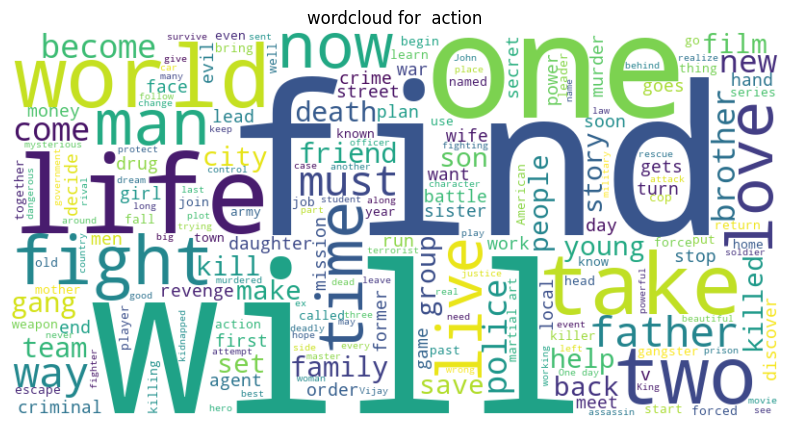

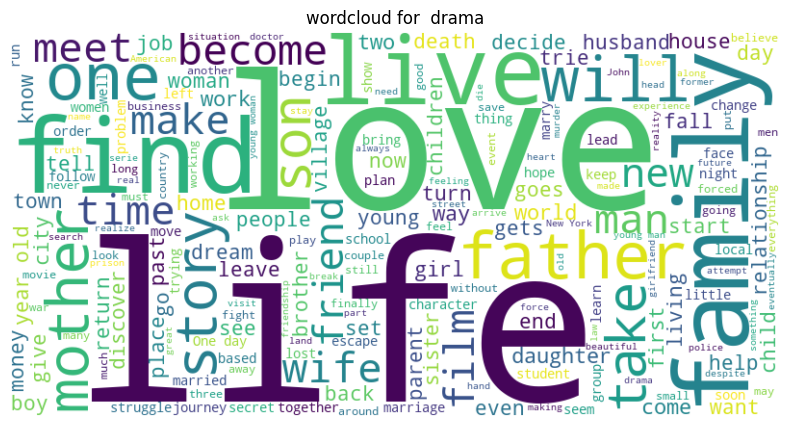

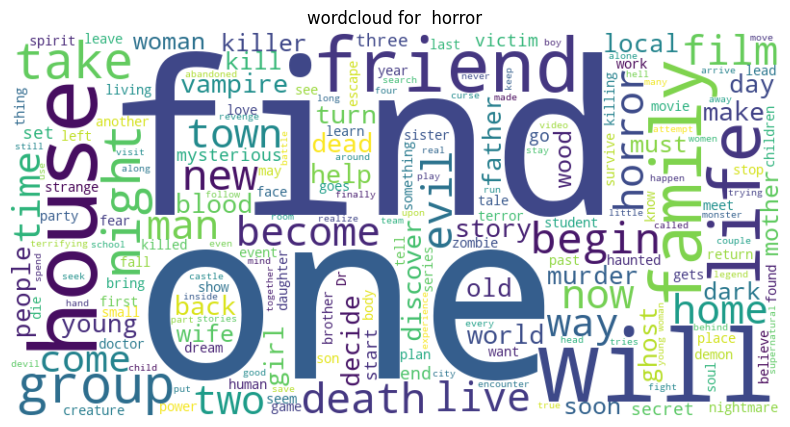

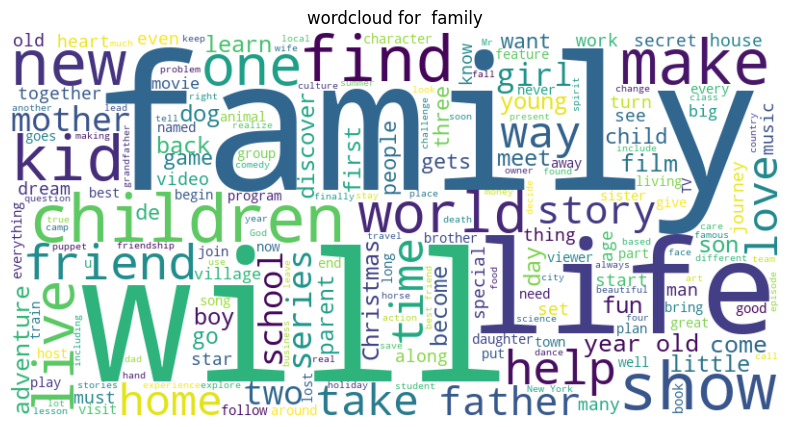

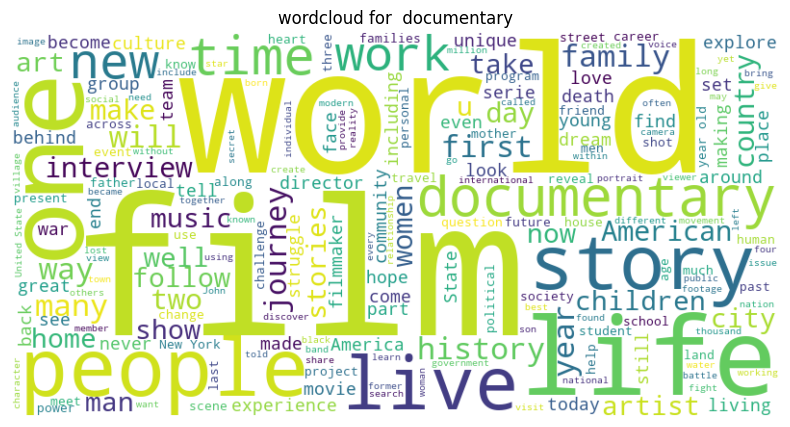

...

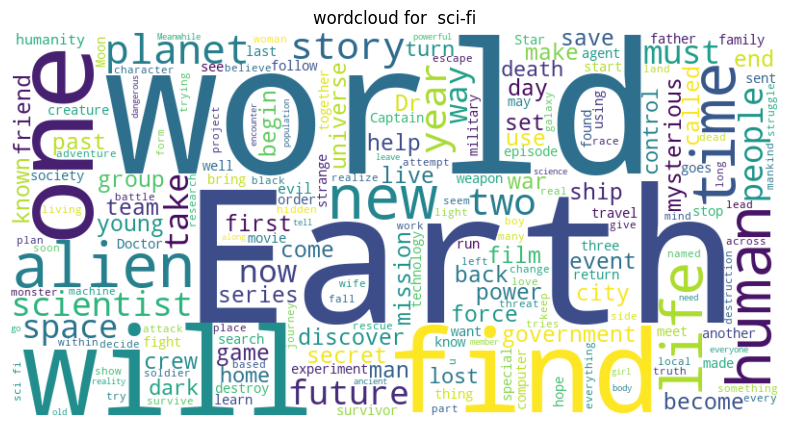

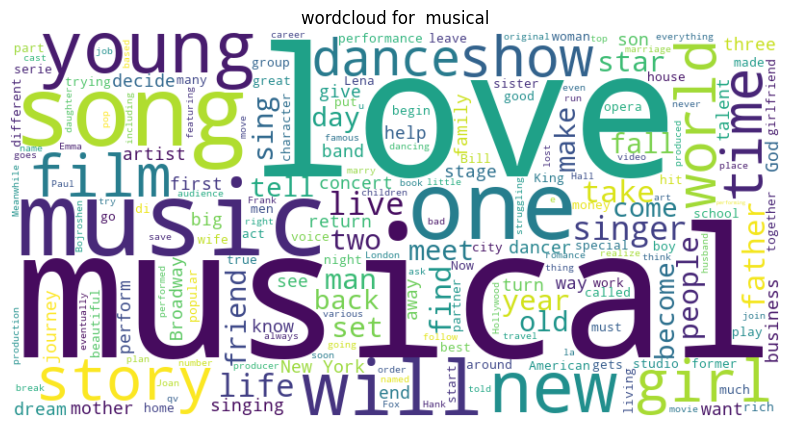

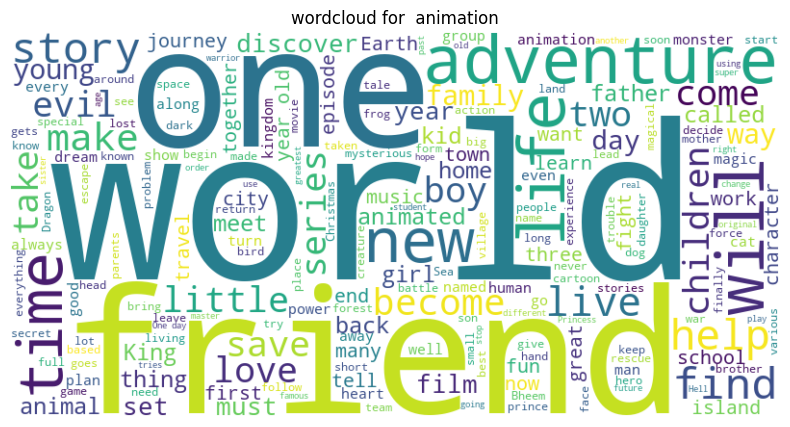

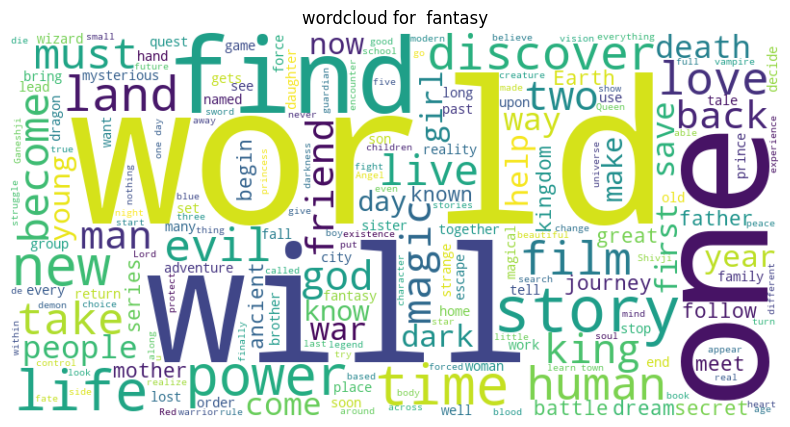

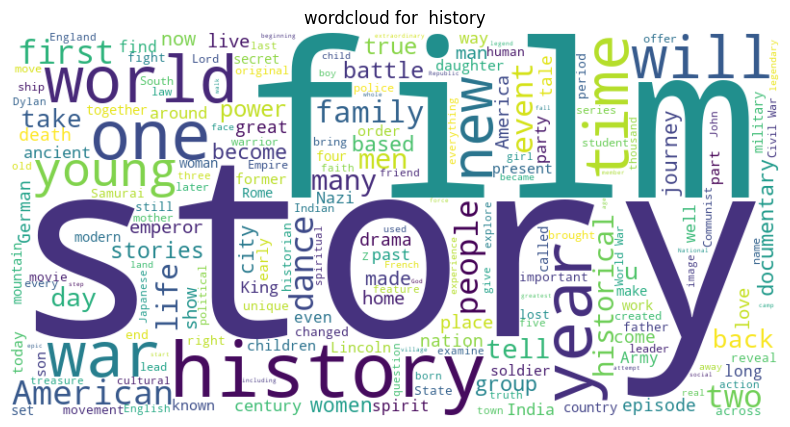

In [45]:
from wordcloud import WordCloud
genres = df_train['genre'].unique()
for genre in genres:
    genre_text = " ".join(df_train[df_train['genre'] == genre]['description'])
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate(genre_text)
    
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.title(f'wordcloud for {genre}')
    plt.axis('off')
    plt.show()

## Cleaning the data

In [54]:
import pandas as pd
import re
import string
import nltk
import spacy
from nltk.corpus import wordnet
from nltk.stem import WordNetLemmatizer
from tqdm import tqdm

nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')
nltk.download('wordnet')
nltk.download('stopwords')

nlp = spacy.load("en_core_web_sm")

lemmatizer = WordNetLemmatizer()

def get_wordnet_pos(word):
    """Map POS tag to first character lemmatize() accepts"""
    tag = nltk.pos_tag([word])[0][1][0].upper()
    tag_dict = {"J": wordnet.ADJ,
                "N": wordnet.NOUN,
                "V": wordnet.VERB,
                "R": wordnet.ADV}
    return tag_dict.get(tag, wordnet.NOUN)

def remove_names(text):
    """Remove named entities from text"""
    doc = nlp(text)
    tokens = [token.text for token in doc if not token.ent_type_ in ["PERSON", "GPE", "LOC", "ORG"]]
    return " ".join(tokens)

def expand_contractions(text):
    """Expand contractions in text"""
    contractions = {
        "isn't": "is not", "he's": "he is", "wasn't": "was not", "there's": "there is",
        "couldn't": "could not", "won't": "will not", "they're": "they are", "she's": "she is",
        "There's": "there is", "wouldn't": "would not", "haven't": "have not", "That's": "That is",
        "you've": "you have", "He's": "He is", "what's": "what is", "weren't": "were not",
        "we're": "we are", "hasn't": "has not", "you'd": "you would", "shouldn't": "should not",
        "let's": "let us", "they've": "they have", "You'll": "You will", "i'm": "i am",
        "we've": "we have", "it's": "it is", "don't": "do not", "that´s": "that is",
        "I´m": "I am", "it’s": "it is", "she´s": "she is", "he’s'": "he is", "I’m": "I am",
        "I’d": "I did", "he’s'": "he is", "there’s": "there is"
    }
    
    for contraction, replacement in contractions.items():
        text = re.sub(contraction, replacement, text)
    return text

def clean_text(text):
    """Clean text by removing punctuation, URLs, numbers, and extra whitespace"""
    text = text.lower()
    text = re.sub('https?://\S+|www\.\S+', '', text)
    text = re.sub(r"\b\d+\b", "", text)
    text = re.sub('<.*?>+', '', text)
    text = re.sub('[%s]' % re.escape(string.punctuation), '', text)
    text = re.sub('\n', ' ', text)
    text = re.sub('[’“”…]', '', text)
    text = re.sub('\s+', ' ', text).strip()
    return text

def remove_stopwords(text):
    """Remove stopwords from text"""
    stopwords = set(nltk.corpus.stopwords.words('english'))
    words = nltk.word_tokenize(text)
    text = " ".join([word for word in words if word not in stopwords and len(word) > 2])
    return text

def lemmatize_text(text):
    """Lemmatize text"""
    words = nltk.word_tokenize(text)
    lemmatized_words = [lemmatizer.lemmatize(word, get_wordnet_pos(word)) for word in words]
    return " ".join(lemmatized_words)

def cleaning_pipeline(text):
    """Apply all cleaning steps to the text in sequence"""
    text = remove_names(text)
    text = expand_contractions(text)
    text = clean_text(text)
    text = remove_stopwords(text)
    text = lemmatize_text(text)
    return text


[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\parmiss\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\parmiss\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\parmiss\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\parmiss\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [ ]:

df_train['description'] = df_train['description'].apply(cleaning_pipeline)
df_train = df_train.drop_duplicates(subset='description')
print(df_train[['genre', 'description']].head())
df_train.to_csv('clean.csv', index=False)

In [57]:

file_path = r'C:\Users\parmiss\Desktop\University\AI\Final Project\clean.csv'
df_train_clean = pd.read_csv(file_path)

### word count distribution after cleaning the data

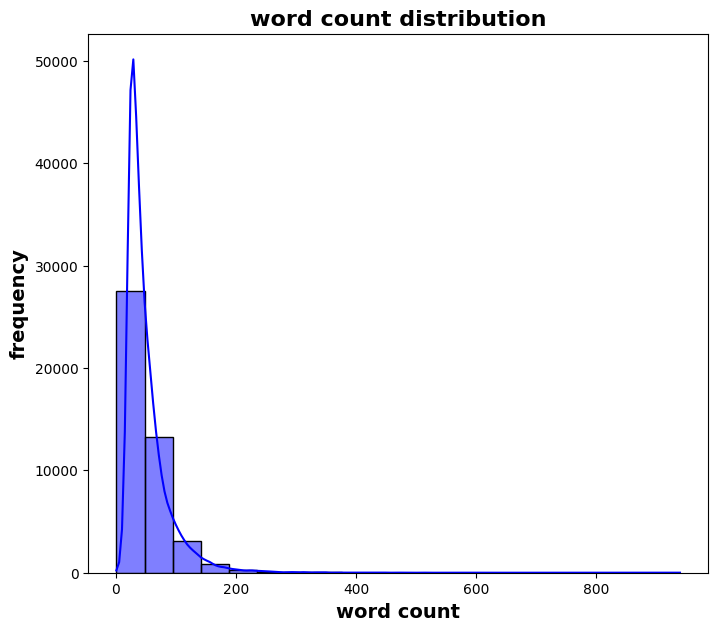

count    45040.000000
mean        51.150400
std         37.422011
min          1.000000
25%         28.000000
50%         40.000000
75%         61.000000
max        939.000000
Name: word_count, dtype: float64


In [62]:
df_train_clean['word_count'] = df_train_clean['description'].apply(lambda x: len(x.split()))

plt.figure(figsize=(8, 7))
sns.histplot(data=df_train_clean, x='word_count', bins=20, kde=True, color='blue')
plt.xlabel('word count', fontsize=14, fontweight='bold')
plt.ylabel('frequency', fontsize=14, fontweight='bold')
plt.title('word count distribution', fontsize=16, fontweight='bold')
plt.show()

print(df_train_clean['word_count'].describe())

## TF-IDF

Calculate Term Frequency (TF): The number of times a term appears in a document divided by the total number of terms in the document.
Calculate Inverse Document Frequency (IDF): The logarithmically scaled inverse fraction of the documents that contain the term.
Combine TF and IDF to get TF-IDF: Multiply the TF and IDF values for each term in each document.

In [70]:
from collections import defaultdict
import math
def compute_tf(doc):
    tf_dict = defaultdict(float)
    words = doc.split()
    total_terms = len(words)
    for word in words:
        tf_dict[word] += 1.0
    for word in tf_dict:
        tf_dict[word] = tf_dict[word] / total_terms
    return tf_dict

def compute_idf(corpus):
    idf_dict = defaultdict(float)
    total_docs = len(corpus)
    for doc in corpus:
        words = set(doc.split())
        for word in words:
            idf_dict[word] += 1.0
    for word in idf_dict:
        idf_dict[word] = math.log(total_docs / (1.0 + idf_dict[word])) + 1.0 
    return idf_dict

def compute_tfidf(tf, idf):
    tfidf_dict = defaultdict(float)
    for word, tf_val in tf.items():
        tfidf_dict[word] = tf_val * idf[word]
    return tfidf_dict

### applying TF-IDF to our train data

In [ ]:
corpus = df_train_clean['description'].tolist()
idf = compute_idf(corpus)
tfidf_matrix = []
for doc in corpus:a
    tf = compute_tf(doc)
    tfidf = compute_tfidf(tf, idf)
    tfidf_matrix.append(tfidf)
all_terms = set(word for tfidf in tfidf_matrix for word in tfidf.keys())
tfidf_df = pd.DataFrame(tfidf_matrix).fillna(0)[all_terms]

### saving embeded train data in a file

In [ ]:
from scipy import sparse
from numpy import savez_compressed

sparse_matrix = sparse.csr_matrix(tfidf_df.values)
column_names = tfidf_df.columns
index = tfidf_df.index
sparse.save_npz('tfidf_sparse.npz', sparse_matrix)
savez_compressed('tfidf_column_names.npz', column_names)
savez_compressed('tfidf_index.npz', index)


### loading embedded train data 

In [73]:
import numpy as np
import pandas as pd
from scipy import sparse

sparse_matrix_loaded = sparse.load_npz('tfidf_sparse.npz')
column_names_loaded = np.load('tfidf_column_names.npz', allow_pickle=True)['arr_0']
index_loaded = np.load('tfidf_index.npz', allow_pickle=True)['arr_0']
tfidf_df_train_test = pd.DataFrame.sparse.from_spmatrix(sparse_matrix_loaded, index=index_loaded, columns=column_names_loaded)
print(tfidf_df_train_test.shape)


(45040, 56485)


## Test-Train Split

In [75]:
from sklearn.model_selection import train_test_split
y = df_train_clean['genre'].values
y_train, y_test,tfidf_df_train,tfidf_df_test = train_test_split(y,tfidf_df_train_test, test_size=0.20, random_state=0)
print('y_train size: {}, y_test size: {},z{}'.format(y_train.shape, y_test.shape,tfidf_df_train.shape))

y_train size: (36032,), y_test size: (9008,),z(36032, 56485)


### visualizng test and train genre distribution

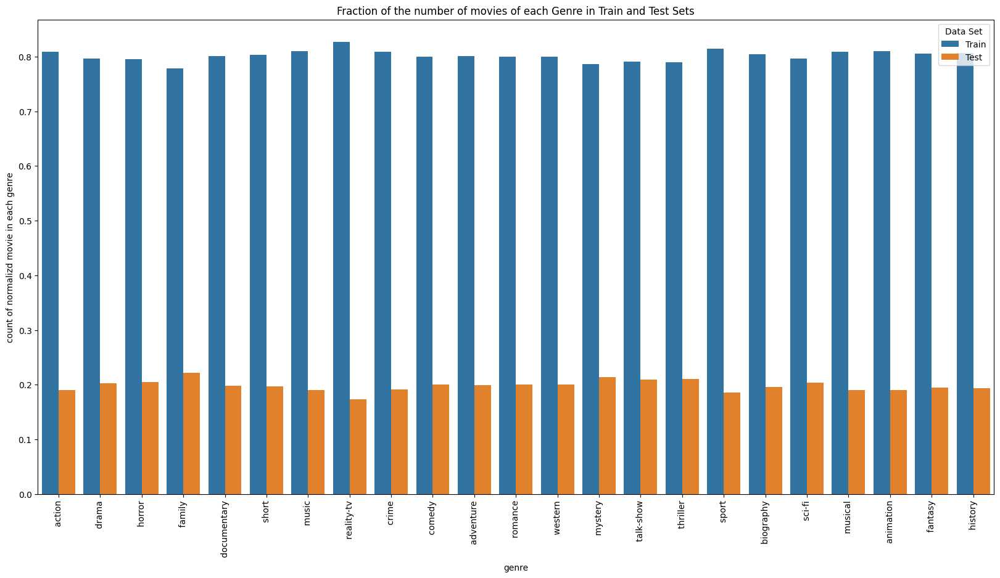

Movies per genre (train and test):
                     Genre     Total Data Set
 action             action  0.809311    Train
 drama               drama  0.797001    Train
 horror             horror  0.795515    Train
 family             family  0.777946    Train
 documentary   documentary  0.801511    Train
 short               short  0.803069    Train
 music               music  0.809524    Train
 reality-tv     reality-tv  0.826435    Train
 crime               crime  0.808411    Train
 comedy             comedy  0.799398    Train
 adventure       adventure  0.800912    Train
 romance           romance  0.799649    Train
 western           western  0.799316    Train
 mystery           mystery  0.785978    Train
 talk-show       talk-show  0.790274    Train
 thriller         thriller  0.789201    Train
 sport               sport  0.814208    Train
 biography       biography  0.804444    Train
 sci-fi             sci-fi  0.796364    Train
 musical           musical  0.809322    Train

In [93]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

all_genres = df_train_clean['genre'].unique()

sum_genre = df_train_clean['genre'].value_counts().reindex(all_genres, fill_value=0)
sum_genre_train = pd.Series(y_train).value_counts().reindex(all_genres, fill_value=0)
sum_genre_test =pd.Series(y_test).value_counts().reindex(all_genres, fill_value=0)


df_movies_per_genre_1 = pd.DataFrame({'Genre': sum_genre_train.index, 'Total': sum_genre_train / sum_genre, 'Data Set': 'Train'})
df_movies_per_genre_2 = pd.DataFrame({'Genre': sum_genre_test.index, 'Total': sum_genre_test / sum_genre, 'Data Set': 'Test'})
df_movies_per_genre = pd.concat([df_movies_per_genre_1, df_movies_per_genre_2])


plt.figure(figsize=(20, 10))
sns.barplot(data=df_movies_per_genre, x='Genre', y='Total', hue='Data Set')
plt.title('Fraction of the number of movies of each Genre in Train and Test Sets')
plt.xlabel('genre')
plt.ylabel('count of normalizd movie in each genre')
plt.xticks(rotation=90)
plt.show()
print("Movies per genre (train and test):")
print(df_movies_per_genre)


## Modeling

### Naive Bayes 

In [114]:
import numpy as np
##class 
def calculate_priors(y_train):
    classes, counts = np.unique(y_train, return_counts=True)
    priors = counts / len(y_train)
    return dict(zip(classes, priors))
##p(c|term)
def calculate_likelihoods(tfidf_df_train, y_train, alpha):
    n_samples, n_features = tfidf_df_train.shape
    classes = np.unique(y_train)
    likelihoods = {}

    for c in classes:
        indices = np.where(y_train == c)
        class_feature_sum = np.sum(tfidf_df_train[indices], axis=0) + alpha
        total_class_count = np.sum(class_feature_sum)
        likelihoods[c] = class_feature_sum / total_class_count
    return likelihoods
##predict
def calculate_posteriors(tfidf_vector, priors, likelihoods):
    posteriors = {}
    for c in priors:
        prior = np.log(priors[c])
        likelihood = np.sum(np.log(likelihoods[c]) * tfidf_vector)
        posteriors[c] = prior + likelihood
    return posteriors

class NaiveBayesClassifier:
    def __init__(self, alpha=1.0):
        self.alpha = alpha
        self.priors = None
        self.likelihoods = None

    def fit(self, tfidf_df_train, y_train):
        self.priors = calculate_priors(y_train)
        self.likelihoods = calculate_likelihoods(tfidf_df_train, y_train, self.alpha)

    def predict(self, tfidf_df_test):
        predictions = []
        for tfidf_vector in tfidf_df_test:
            posteriors = calculate_posteriors(tfidf_vector, self.priors, self.likelihoods)
            predictions.append(max(posteriors, key=posteriors.get))
        return np.array(predictions)

    def score(self, tfidf_df_test, y_test):
        predictions = self.predict(tfidf_df_test)
        return np.mean(predictions == y_test)

    def evaluate(self, tfidf_df_test, y_test):
        predictions = self.predict(tfidf_df_test)
        precision_dict, recall_dict, f1_dict, precision_weighted, recall_weighted, f1_weighted, accuracy = self.calculate_metrics(y_test, predictions)
        return precision_dict, recall_dict, f1_dict, precision_weighted, recall_weighted, f1_weighted, accuracy

    def calculate_metrics(self, y_true, y_pred):
        classes = np.unique(y_true)
        precision_dict = {}
        recall_dict = {}
        f1_dict = {}

        for c in classes:
            tp = np.sum((y_pred == c) & (y_true == c))
            fp = np.sum((y_pred == c) & (y_true != c))
            fn = np.sum((y_pred != c) & (y_true == c))

            precision = tp / (tp + fp) if (tp + fp) > 0 else 0
            recall = tp / (fn + tp) if (fn + tp) > 0 else 0
            f1 = (2 * precision * recall) / (precision + recall) if (precision + recall) > 0 else 0

            precision_dict[c] = precision
            recall_dict[c] = recall
            f1_dict[c] = f1

        precision_weighted = np.average(list(precision_dict.values()), weights=[np.sum(y_true == c) for c in classes])
        recall_weighted = np.average(list(recall_dict.values()), weights=[np.sum(y_true == c) for c in classes])
        f1_weighted = np.average(list(f1_dict.values()), weights=[np.sum(y_true == c) for c in classes])

        accuracy = np.sum(y_true == y_pred) / len(y_true)

        return precision_dict, recall_dict, f1_dict, precision_weighted, recall_weighted, f1_weighted, accuracy

def tune_alpha(tfidf_df_train, y_train, tfidf_df_test, y_test, alpha_values):
    best_alpha = None
    best_score = 0

    for alpha in alpha_values:
        model = NaiveBayesClassifier(alpha=alpha)
        model.fit(tfidf_df_train, y_train)
        score = model.score(tfidf_df_test, y_test)

        if score > best_score:
            best_score = score
            best_alpha = alpha

    return best_alpha, best_score,model


### Testing alpha to find the best based on score(validation)

In [ ]:
alpha_values = [0,0.0001,0.01,0.02,0.05,0.1,0.5,1.0,2.0,5.0]
best_alpha, best_score ,model = tune_alpha(tfidf_df_train, y_train, tfidf_df_test, y_test, alpha_values)
print(f"Best Alpha: {best_alpha}, Best Score: {best_score}")

Alpha: 0, Score: 0.023645648312611012

Alpha: 1e-05, Score: 0.49345026642984013

Alpha: 0.01, Score: 0.5370781527531083

Alpha: 0.02, Score: 0.5368561278863233

Alpha: 0.05, Score: 0.5295293072824157

Alpha: 0.1, Score: 0.5096580817051509

Alpha: 0.5, Score: 0.4612566607460036

Alpha: 1.0, Score: 0.4509325044404973

Alpha: 2.0, Score: 0.4452708703374778

Alpha: 5.0, Score: 0.44182948490230906

Best alpha: 0.01, Best score: 0.5370781527531083



the best alpha is 0.01 fit the model with this value

### saving and reloading model for  later 

In [116]:
alpha_values = [0.01]
best_alpha, best_score ,model = tune_alpha(np.array(tfidf_df_train), np.array(y_train), np.array(tfidf_df_test), np.array(y_test), alpha_values)

In [123]:
import pickle
def save_model(model, filename):
    with open(filename, 'wb') as file:
        pickle.dump(model, file)

save_model(model, 'naive_bayes_model.pkl')


In [ ]:
import pickle

def save_model(model, path):

    with open(path, 'wb') as file:
        pickle.dump(model, file)

model_path = r'C:\Users\parmiss\Desktop\my_model.pkl'
save_model(model, model_path)

In [ ]:
import pickle
def load_model(filename):
    with open(filename, 'rb') as file:
        model = pickle.load(file)
    return model
model =load_model('my_model.pkl')

Alpha: 0.01, Score: 0.5370781527531083


## Test

### cleaning test data and storing

In [ ]:
df_test['description'] = df_test['description'].apply(cleaning_pipeline)
df_test.to_csv('cleanedTest.csv', index=False)

### reloading cleaned test

In [128]:
df_test_clean =(pd.read_csv('cleanedTest.csv'))

### TF-IDF for test data and saving

In [ ]:
all_terms=np.array(tfidf_df_train_test.keys())

In [80]:
corpus = df_test_clean['description'].tolist()
idf = compute_idf(corpus)
tfidf_matrix = []
for doc in corpus:
    tf = compute_tf(doc)
    tfidf = compute_tfidf(tf, idf)
    tfidf_matrix.append(tfidf)

tfidf_df_actual_test = pd.DataFrame(tfidf_matrix).fillna(0)
missing_terms = [term for term in all_terms if term not in tfidf_df_actual_test.columns]
for term in missing_terms:
    tfidf_df_actual_test[term] = 0
tfidf_df_actual_test = tfidf_df_actual_test[all_terms]

from scipy import sparse
sparse_matrix = sparse.csr_matrix(tfidf_df_actual_test.values)
column_names = tfidf_df_actual_test.columns
index = tfidf_df_actual_test.index

from numpy import savez_compressed
sparse.save_npz('testEmbeding_sparse.npz', sparse_matrix)
savez_compressed('testEmbeding_column_names.npz', column_names)
savez_compressed('testEmbeding_index.npz', index)


Missing terms: ['activités', 'sodbury', 'ungratefulness', 'tamotsu', 'quei', 'clonic', 'whew', 'freesurfing', 'jollity', 'pfouts', 'midland', 'rabitzer', 'prenestina', 'biais', 'kinshasa', 'ang', 'binod', 'arabi', '1914and', 'cochise', 'scruple', 'shaq', 'dusk', 'bargirl', 'interlinks', 'paltera', 'zazen', 'dispensation', 'sao', 'blankman', 'manen', '1990ies', 'skyros', 'irv', 'ferfival', 'unforgiven', 'seguridad', 'dowdy', 'cihans', '64th', 'vitreous', 'dallo', 'unfrocked', 'verarmten', 'pentecostal', 'luchador', 'ramani', 'provincetown', 'costanza', 'byrd', 'horrifies', 'considera', 'scotish', 'asco', 'langya', 'hards', 'familynames', 'asroman', 'soll', 'suspender', 'swankiest', 'funnily', 'shuzhi', 'ormai', 'penglisch', 'disastroso', 'pondo', 'solstice', 'dornier', 'uotatsu', 'shipper', 'contrebande', 'gunaah', 'quip', 'thrombosis', 'trickier', 'realigns', 'ethnos', 'senasica', 'parrott', 'hla', 'pasión', 'wga', 'veterano', 'hilltop', 'satin', 'quipped', 'egen', 'anastasia', 'brett'

C:\Users\parmiss\AppData\Local\Temp\ipykernel_20720\898539626.py:20: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  tfidf_df[term] = 0
C:\Users\parmiss\AppData\Local\Temp\ipykernel_20720\898539626.py:20: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  tfidf_df[term] = 0
C:\Users\parmiss\AppData\Local\Temp\ipykernel_20720\898539626.py:20: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.conc

### loading embbede test 

In [129]:
import numpy as np
import pandas as pd
from scipy import sparse

sparse_matrix_loaded = sparse.load_npz('testEmbeding_sparse.npz')
column_names_loaded = np.load('testEmbeding_column_names.npz', allow_pickle=True)['arr_0']
index_loaded = np.load('testEmbeding_index.npz', allow_pickle=True)['arr_0']
tfidf_df_actual_test = pd.DataFrame.sparse.from_spmatrix(sparse_matrix_loaded, index=index_loaded, columns=column_names_loaded)

## Evaluating the model

In [134]:

precision_dict, recall_dict, f1_dict, precision_weighted, recall_weighted, f1_weighted, accuracy = model.evaluate(np.array(tfidf_df_actual_test),np.array(df_test['genre']))
print(f'Precision per class: {precision_dict}')
print(f'Recall per class: {recall_dict}')
print(f'F1 Score per class: {f1_dict}')
print(f'Weighted Precision: {precision_weighted}')
print(f'Weighted Recall: {recall_weighted}')
print(f'Weighted F1: {f1_weighted}')
print(f'Accuracy: {accuracy}')


Precision per class: {' action': 0.5342465753424658, ' adventure': 0.6956521739130435, ' animation': 0.8333333333333334, ' biography': 0.0, ' comedy': 0.5710955710955711, ' crime': 0.5, ' documentary': 0.5832132564841499, ' drama': 0.4762182667055734, ' family': 0.3, ' fantasy': 0.3333333333333333, ' history': 0.0, ' horror': 0.7259615384615384, ' music': 0.6417910447761194, ' musical': 0.0, ' mystery': 0, ' reality-tv': 0.48148148148148145, ' romance': 0.5, ' sci-fi': 0.6666666666666666, ' short': 0.4847328244274809, ' sport': 0.65, ' talk-show': 0.08333333333333333, ' thriller': 0.35555555555555557, ' western': 0.9478260869565217}
Recall per class: {' action': 0.19796954314720813, ' adventure': 0.13793103448275862, ' animation': 0.06666666666666667, ' biography': 0.0, ' comedy': 0.4386750223813787, ' crime': 0.013157894736842105, ' documentary': 0.8243380855397149, ' drama': 0.7992164544564153, ' family': 0.02564102564102564, ' fantasy': 0.041666666666666664, ' history': 0.0, ' horro

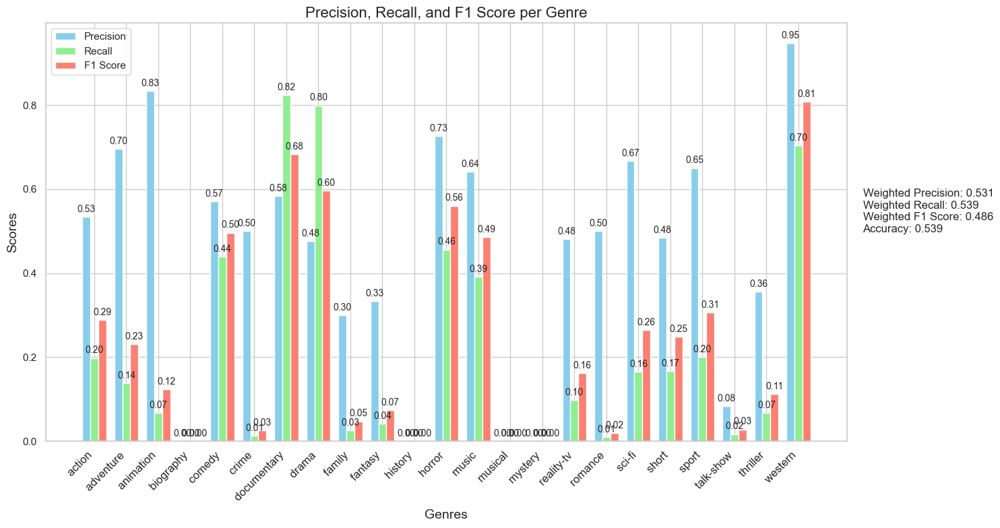

In [137]:
import matplotlib.pyplot as plt
import seaborn as sns

classes = list(precision_dict.keys())
precision = list(precision_dict.values())
recall = list(recall_dict.values())
f1 = list(f1_dict.values())
x = np.arange(len(classes))  
width = 0.25  
fig, ax = plt.subplots(figsize=(15, 8))
rects1 = ax.bar(x - width, precision, width, label='Precision', color='skyblue')
rects2 = ax.bar(x, recall, width, label='Recall', color='lightgreen')
rects3 = ax.bar(x + width, f1, width, label='F1 Score', color='salmon')

ax.set_xlabel('Genres', fontsize=14)
ax.set_ylabel('Scores', fontsize=14)
ax.set_title('Precision, Recall, and F1 Score per Genre', fontsize=16)
ax.set_xticks(x)
ax.set_xticklabels(classes, rotation=45, ha='right', fontsize=12)
ax.legend()

weighted_text = (f'Weighted Precision: {precision_weighted:.3f}\n'
                 f'Weighted Recall: {recall_weighted:.3f}\n'
                 f'Weighted F1 Score: {f1_weighted:.3f}\n'
                 f'Accuracy: {accuracy:.3f}')
plt.text(1.02, 0.5, weighted_text, transform=ax.transAxes,
         fontsize=12, bbox=dict(facecolor='white', alpha=0.5))

def add_bar_labels(rects):
    for rect in rects:
        height = rect.get_height()
        ax.annotate(f'{height:.2f}', xy=(rect.get_x() + rect.get_width() / 2, height),
                    xytext=(0, 3), 
                    textcoords="offset points",
                    ha='center', va='bottom', fontsize=10)

add_bar_labels(rects1)
add_bar_labels(rects2)
add_bar_labels(rects3)

plt.tight_layout()
plt.show()